In [1]:
import pandas as pd
import numpy as np
from scipy.sparse import hstack,csc_matrix

import nltk
import contractions
from wordcloud import WordCloud
from nltk.stem import WordNetLemmatizer
from itertools import chain
from sklearn.preprocessing import StandardScaler
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.model_selection import train_test_split,GridSearchCV


import matplotlib.pyplot as plt
import plotly.express as ex

from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.linear_model import SGDClassifier
from sklearn.naive_bayes import BernoulliNB
from sklearn.metrics import classification_report,plot_confusion_matrix

%matplotlib inline

<frozen importlib._bootstrap>:219: RuntimeWarning: numpy.ufunc size changed, may indicate binary incompatibility. Expected 192 from C header, got 216 from PyObject


In [3]:
#descargas necesarias para nltk
nltk.download('punkt')
nltk.download('stopwords')
nltk.download('wordnet')
nltk.download('averaged_perceptron_tagger')
nltk.download('universal_tagset')

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Nicolas\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Nicolas\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Nicolas\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\Nicolas\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package universal_tagset to
[nltk_data]     C:\Users\Nicolas\AppData\Roaming\nltk_data...
[nltk_data]   Package universal_tagset is already up-to-date!


True

In [4]:
df=pd.read_csv("Reviews.csv")
df.head()

,Id,ProductId,UserId,ProfileName,HelpfulnessNumerator,HelpfulnessDenominator,Score,Time,Summary,Text
0,1,B001E4KFG0,A3SGXH7AUHU8GW,delmartian,1,1,5,1303862400,Good Quality Dog Food,I have bought several of the Vitality canned d...
1,2,B00813GRG4,A1D87F6ZCVE5NK,dll pa,0,0,1,1346976000,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...
2,3,B000LQOCH0,ABXLMWJIXXAIN,"Natalia Corres ""Natalia Corres""",1,1,4,1219017600,"""Delight"" says it all",This is a confection that has been around a fe...
3,4,B000UA0QIQ,A395BORC6FGVXV,Karl,3,3,2,1307923200,Cough Medicine,If you are looking for the secret ingredient i...
4,5,B006K2ZZ7K,A1UQRSCLF8GW1T,"Michael D. Bigham ""M. Wassir""",0,0,5,1350777600,Great taffy,Great taffy at a great price. There was a wid...


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 568454 entries, 0 to 568453
Data columns (total 10 columns):
 #   Column                  Non-Null Count   Dtype 
---  ------                  --------------   ----- 
 0   Id                      568454 non-null  int64 
 1   ProductId               568454 non-null  object
 2   UserId                  568454 non-null  object
 3   ProfileName             568438 non-null  object
 4   HelpfulnessNumerator    568454 non-null  int64 
 5   HelpfulnessDenominator  568454 non-null  int64 
 6   Score                   568454 non-null  int64 
 7   Time                    568454 non-null  int64 
 8   Summary                 568427 non-null  object
 9   Text                    568454 non-null  object
dtypes: int64(5), object(5)
memory usage: 43.4+ MB


In [6]:
# se convertira el timestamp a objeto date por sentido práctico desde el principio y se eliminará la columna
df["Date"]=df.Time.apply(lambda d: pd.Timestamp(d,unit='s').date())
del df["Time"]
df["Summary"]=df["Summary"].astype(str)
df["Text"]=df["Text"].astype(str)

# EDA

## Product ID

In [7]:
#identificar elementos diferentes
prod_df=df[["Id","ProductId"]].groupby(["ProductId"]).count().sort_values("Id").copy()
prod_df.columns=["NumReviews"]
print(prod_df["NumReviews"].mean())
prod_df

7.655121333728353


,NumReviews
ProductId,
B009WVB40S,1
B0042RKTG2,1
B001326V4S,1
B0042RMG3Q,1
B0012ZTVKM,1
...,...
B002QWHJOU,632
B0026RQTGE,632
B002QWP8H0,632


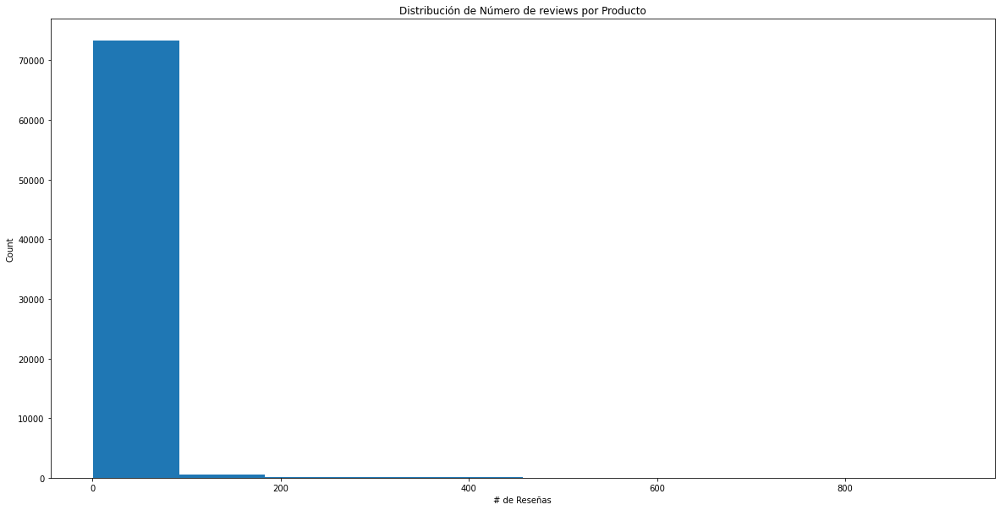

In [8]:
plt.figure(figsize=(20,10))
plt.title("Distribución de Número de reviews por Producto")
plt.xlabel("# de Reseñas")
plt.ylabel("Count")
plt.hist(prod_df[prod_df["NumReviews"]<1000].values)
plt.show()

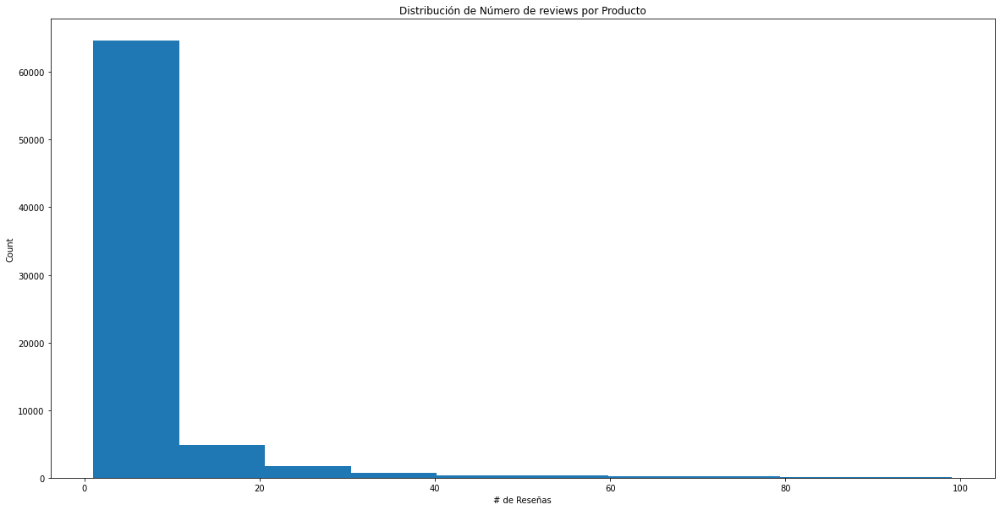

In [9]:
plt.figure(figsize=(20,10))
plt.title("Distribución de Número de reviews por Producto")
plt.xlabel("# de Reseñas")
plt.ylabel("Count")
plt.hist(prod_df[prod_df["NumReviews"]<100].values)
plt.show()

In [10]:
del prod_df

## UserID

In [11]:
#identificar elementos diferentes
user_df=df[["Id","UserId"]].groupby(["UserId"]).count().sort_values("Id").copy()
user_df.columns=["NumReviews"]
print(user_df["NumReviews"].mean())
user_df

2.2200117941568154


,NumReviews
UserId,
#oc-R103C0QSV1DF5E,1
A3AB2W8OYYL4DG,1
A3AB5FA757IC04,1
A3AB5NCZTG09FO,1
A3AB5NNX7U8LDE,1
...,...
A1Z54EM24Y40LL,256
A281NPSIMI1C2R,365
AY12DBB0U420B,389


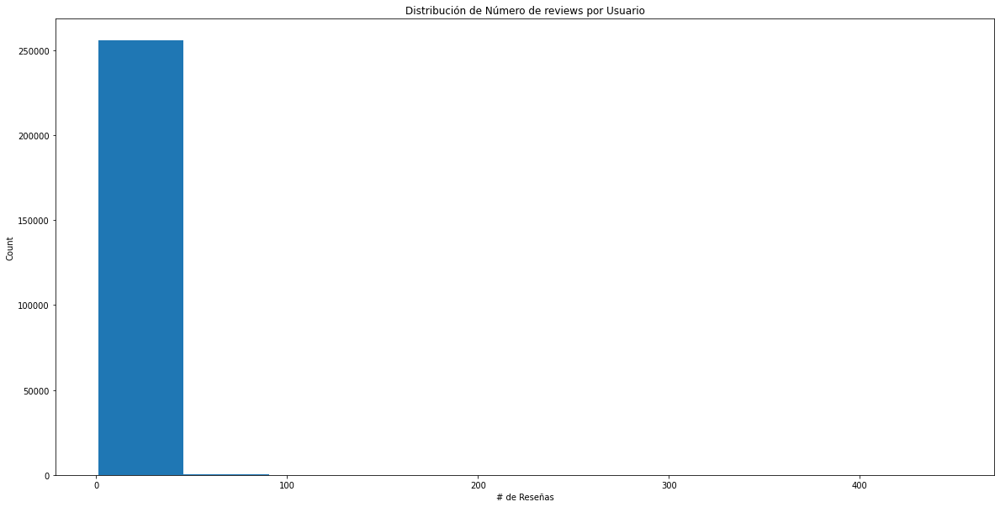

In [12]:
plt.figure(figsize=(20,10))
plt.title("Distribución de Número de reviews por Usuario")
plt.xlabel("# de Reseñas")
plt.ylabel("Count")
plt.hist(user_df["NumReviews"].values)
plt.show()

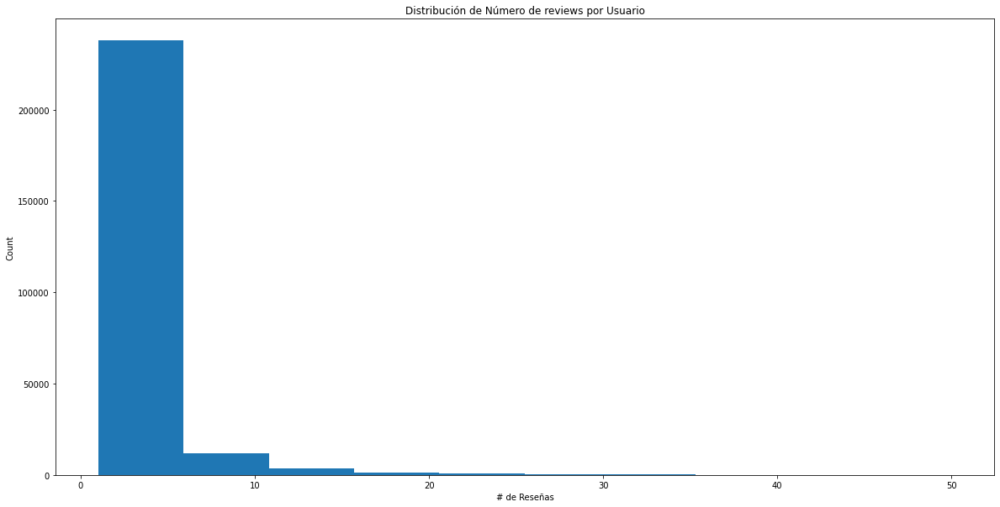

In [13]:
plt.figure(figsize=(20,10))
plt.title("Distribución de Número de reviews por Usuario")
plt.xlabel("# de Reseñas")
plt.ylabel("Count")
plt.hist(user_df[user_df["NumReviews"]<=50].values)
plt.show()

In [14]:
del user_df

## Helpfulness

In [15]:
df[df["HelpfulnessDenominator"]==0]["HelpfulnessDenominator"].count()

270052

Para determinar que tan útil vamos a crear una variable de utilidad. Para no incurrir en divisiones por 0 o asumir que una variable que no tiene likes o dislikes es mala vamos a usar la siguiente formula
$${utilida\in\mathbb{Z}}$$
$${utilidad=(HelpfulnessNumerator)-(HelpfulnessDenominator-HelpfulnessNumerator)}$$
$${\equiv}$$
$${utilidad=(2*HelpfulnessNumerator)-HelpfulnessDenominator}$$
esto le dará un valor neutro de 0 a las reseñas que no tienen likes o dislikes, un valor mayor a 0 para útiles y uno menor a 0 para las que no son útiles
<br>
por razones prácticas y para poder seguir con el analisis se hará acá mismo la fabricación de utilidad y la eliminación de las variables de Helpfulness

In [16]:
df["Helpfulness"]=(2*df["HelpfulnessNumerator"])-df["HelpfulnessDenominator"]

In [17]:
del df["HelpfulnessDenominator"]
del df["HelpfulnessNumerator"]

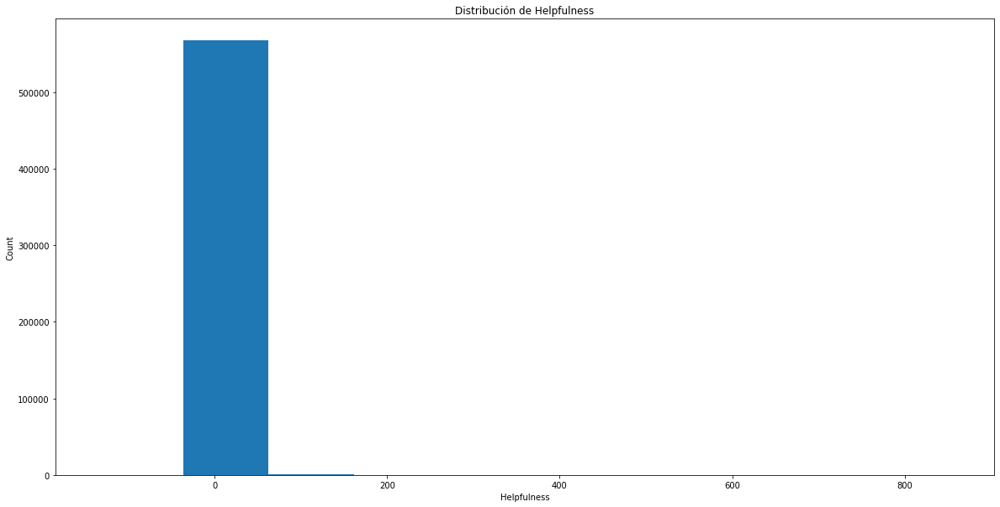

In [18]:
plt.figure(figsize=(20,10))
plt.title("Distribución de Helpfulness")
plt.xlabel("Helpfulness")
plt.ylabel("Count")
plt.hist(df["Helpfulness"].values)
plt.show()

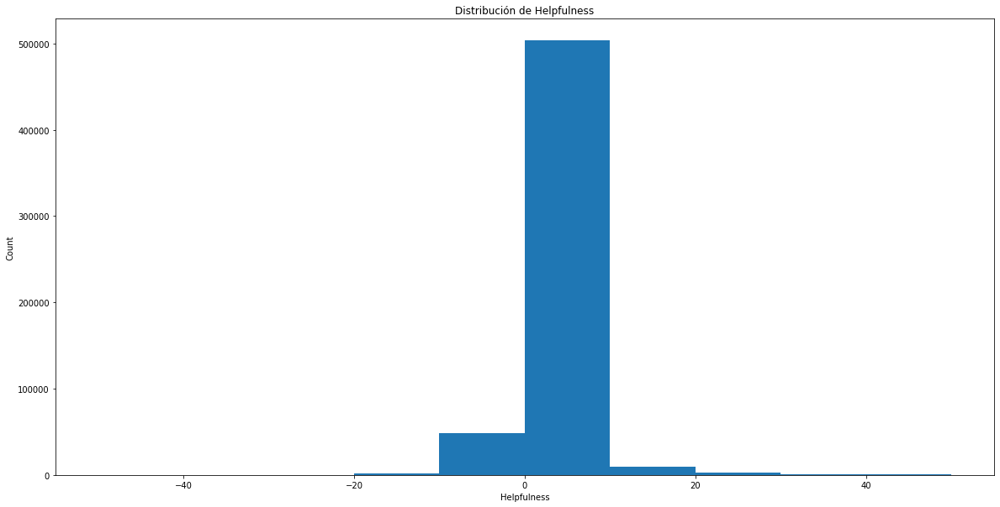

In [19]:
plt.figure(figsize=(20,10))
plt.title("Distribución de Helpfulness")
plt.xlabel("Helpfulness")
plt.ylabel("Count")
plt.hist(df[abs(df["Helpfulness"])<=50]["Helpfulness"].values)
plt.show()

## Score

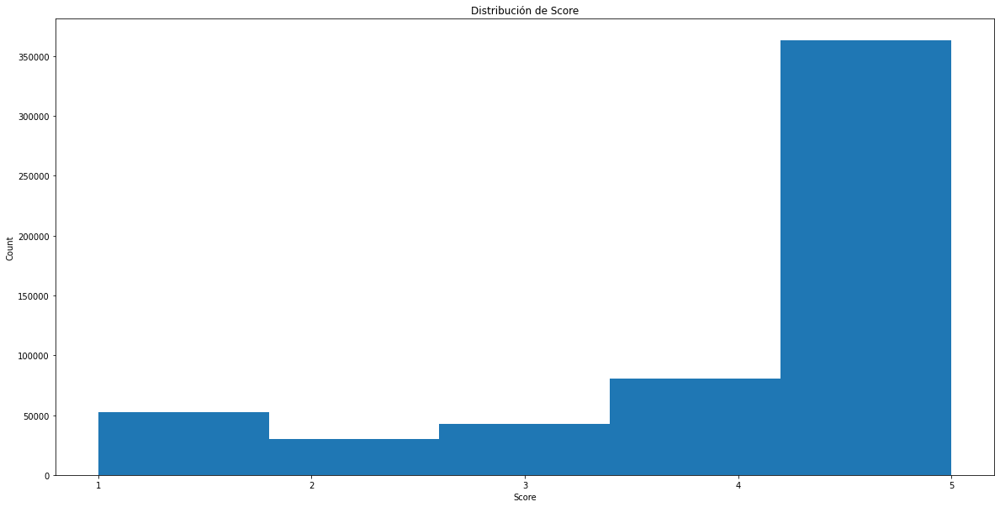

In [20]:
plt.figure(figsize=(20,10))
plt.title("Distribución de Score")
plt.xlabel("Score")
plt.ylabel("Count")
plt.hist(df["Score"].values,bins=5)
plt.xticks([1,2,3,4,5])
plt.show()

## Date

In [21]:
ex.histogram(df,x="Date")

In [22]:
df_date=df.copy()
df_date["day_year"]=df_date["Date"].apply(lambda d: d.timetuple().tm_yday)
ex.histogram(df_date,x="day_year",color="Score")

In [23]:
ex.histogram(df_date[df_date["Helpfulness"]<0],x="day_year",color="Score")

In [24]:
ex.histogram(df_date[df_date["Helpfulness"]==0],x="day_year",color="Score")

In [25]:
ex.histogram(df_date[df_date["Helpfulness"]>0],x="day_year",color="Score")

## Summary

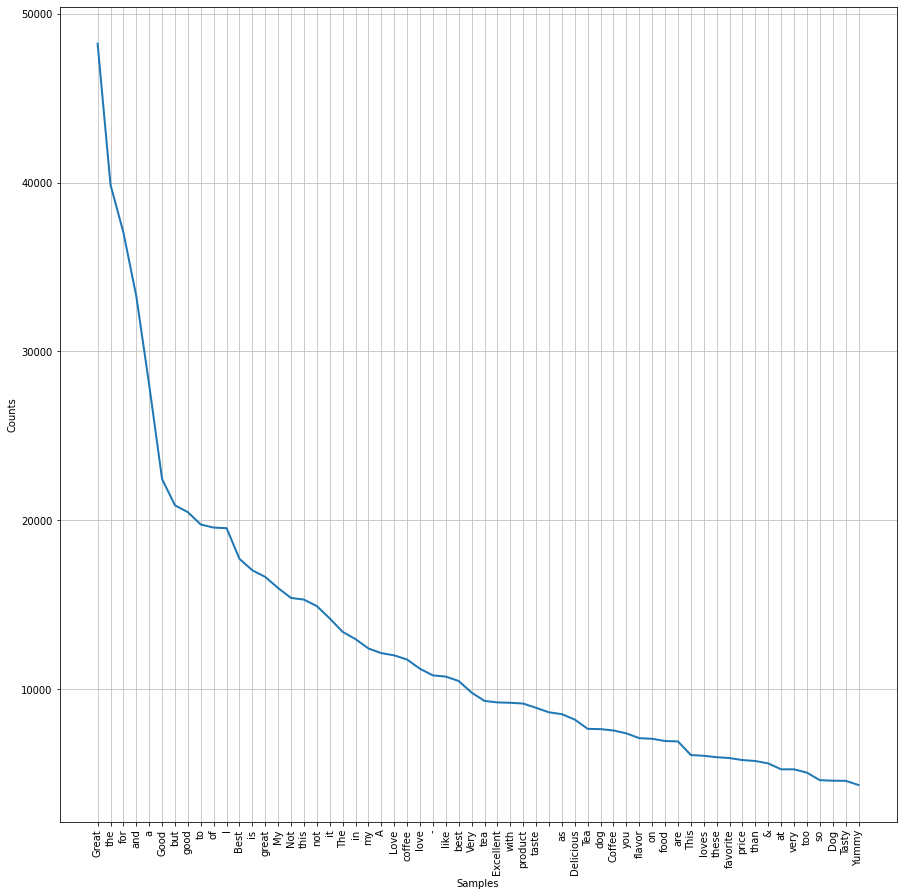

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [26]:
frequency_dist = nltk.FreqDist(list(chain.from_iterable(df["Summary"].apply(lambda d: d.split(' ')).values)))
plt.figure(figsize=(15,15))
frequency_dist.plot(60,cumulative=False)

(-0.5, 399.5, 199.5, -0.5)

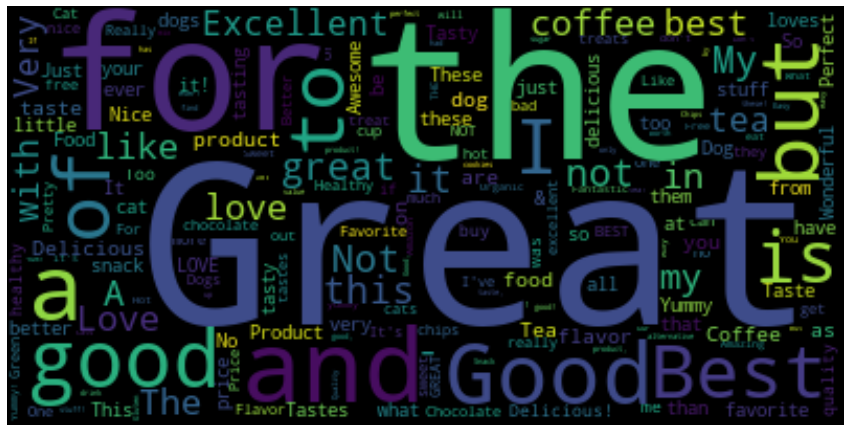

In [27]:
wcloud = WordCloud().generate_from_frequencies(frequency_dist)
plt.figure(figsize=(15,15))
plt.imshow(wcloud, interpolation='bilinear')
plt.axis("off")

<AxesSubplot:title={'center':'Size distribution of Summary'}, ylabel='Frequency'>

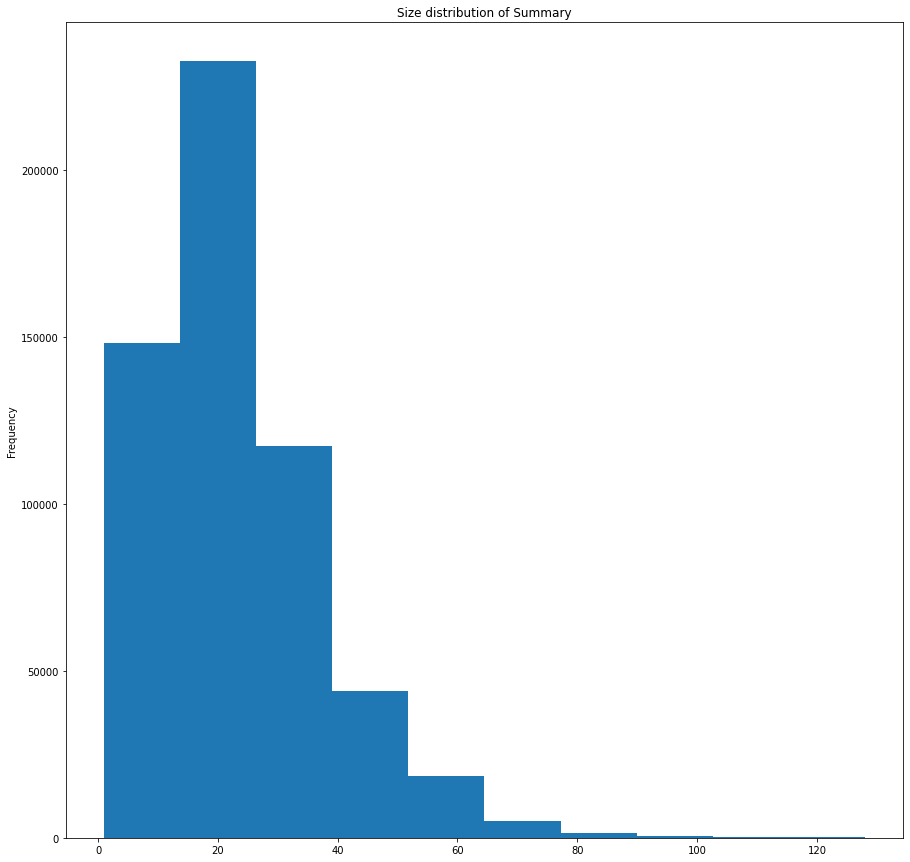

In [28]:
plt.figure(figsize=(15,15))
plt.title("Size distribution of Summary")
df["Summary"].apply(lambda d:len(d)).plot.hist()

In [29]:
df["Summary"].apply(lambda d:len(d)).describe()

count    568454.000000
mean         23.445887
std          14.028439
min           1.000000
25%          13.000000
50%          20.000000
75%          30.000000
max         128.000000
Name: Summary, dtype: float64

## Text

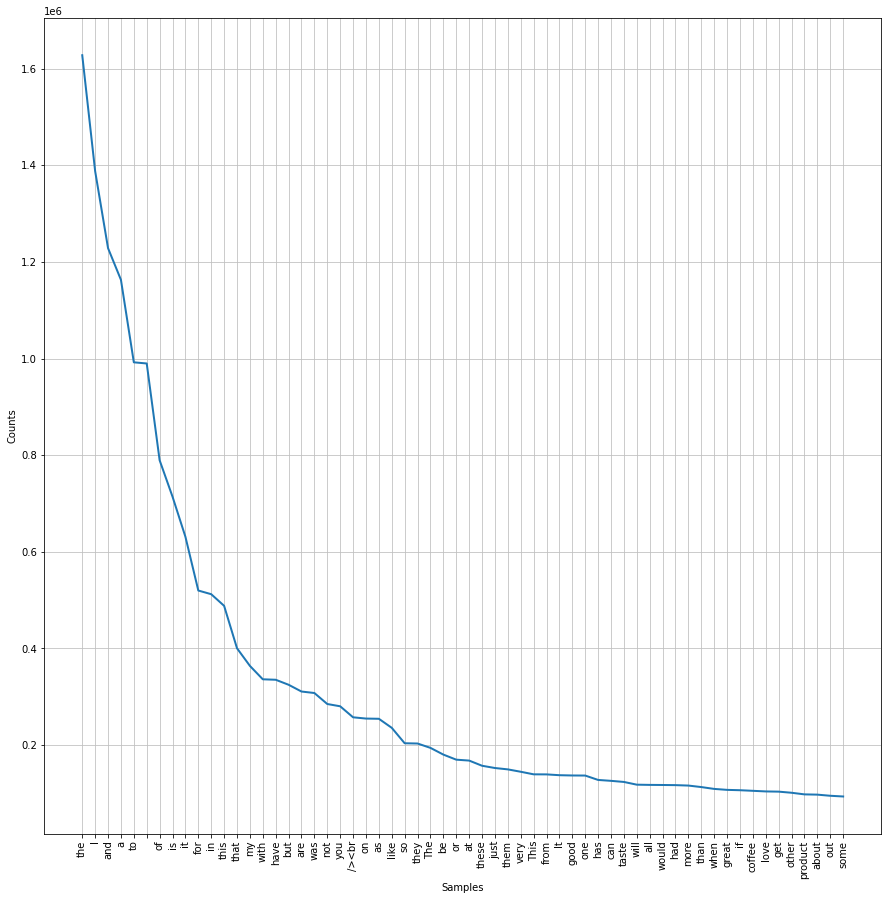

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [30]:
frequency_dist = nltk.FreqDist(list(chain.from_iterable(df["Text"].apply(lambda d: d.split(' ')).values)))
plt.figure(figsize=(15,15))
frequency_dist.plot(60,cumulative=False)

(-0.5, 399.5, 199.5, -0.5)

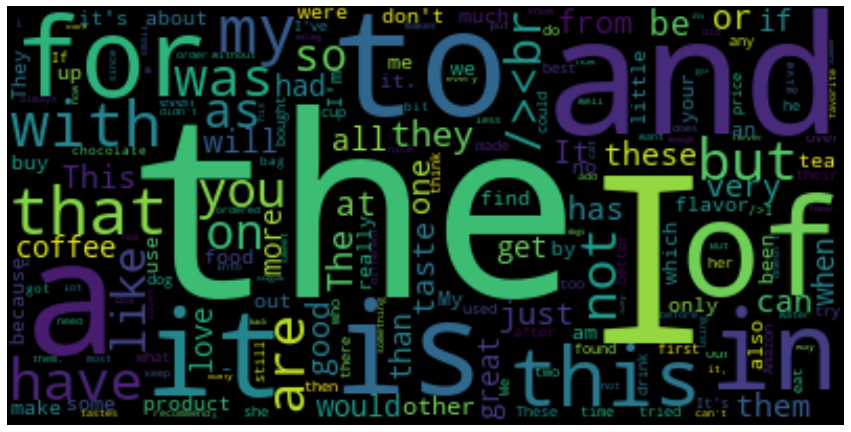

In [31]:
wcloud = WordCloud().generate_from_frequencies(frequency_dist)
plt.figure(figsize=(15,15))
plt.imshow(wcloud, interpolation='bilinear')
plt.axis("off")

<AxesSubplot:title={'center':'Size distribution of Text'}, ylabel='Frequency'>

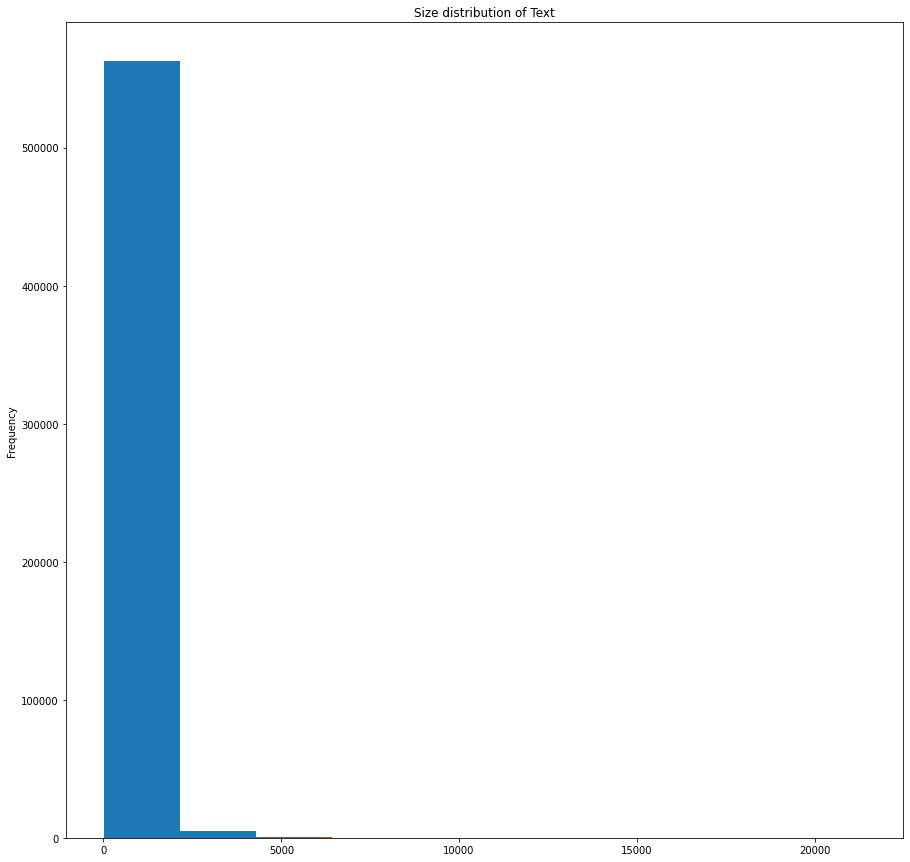

In [32]:
plt.figure(figsize=(15,15))
plt.title("Size distribution of Text")
df["Text"].apply(lambda d:len(d)).plot.hist()

In [33]:
df["Text"].apply(lambda d:len(d)).describe()

count    568454.000000
mean        436.222083
std         445.339741
min          12.000000
25%         179.000000
50%         302.000000
75%         527.000000
max       21409.000000
Name: Text, dtype: float64

# Pre procesamiento

In [34]:
df_pros=df.copy()

## Eliminar columnas que no son de interes
- id: se eliminará dado que es el RowId proporcionado por la BD SqlLite
- ProductId: puesto que nuestro interés es sobre los comentarios para identificar productos buenos lo eliminaremos
- UserId: no nos proporciona información útil, nuestro interés está sobre los comentarios
- Profile name: no nos proporciona información útil, nuestro interés está sobre los comentarios
- Date: se va a eliminar dado que determinamos que los comentarios distribuyen uniformemente a lo largo del año

In [35]:
del df_pros["Id"]
del df_pros["ProductId"]
del df_pros["UserId"]
del df_pros["ProfileName"]
del df_pros["Date"]

In [36]:
df_pros.head()

,Score,Summary,Text,Helpfulness
0,5,Good Quality Dog Food,I have bought several of the Vitality canned d...,1
1,1,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,0
2,4,"""Delight"" says it all",This is a confection that has been around a fe...,1
3,2,Cough Medicine,If you are looking for the secret ingredient i...,3
4,5,Great taffy,Great taffy at a great price. There was a wid...,0


## Normalizar y eliminar extremos en Helpfulness

In [37]:
helpfulness=df_pros["Helpfulness"].copy()

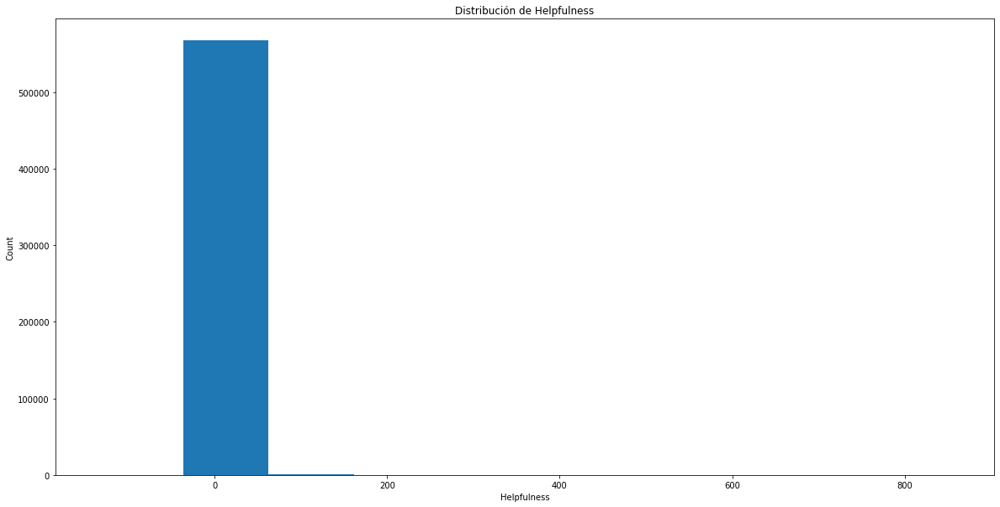

In [38]:
plt.figure(figsize=(20,10))
plt.title("Distribución de Helpfulness")
plt.xlabel("Helpfulness")
plt.ylabel("Count")
plt.hist(helpfulness.values)
plt.show()

In [39]:
scaler_help=StandardScaler()
helpfulness=scaler_help.fit_transform([helpfulness.values])

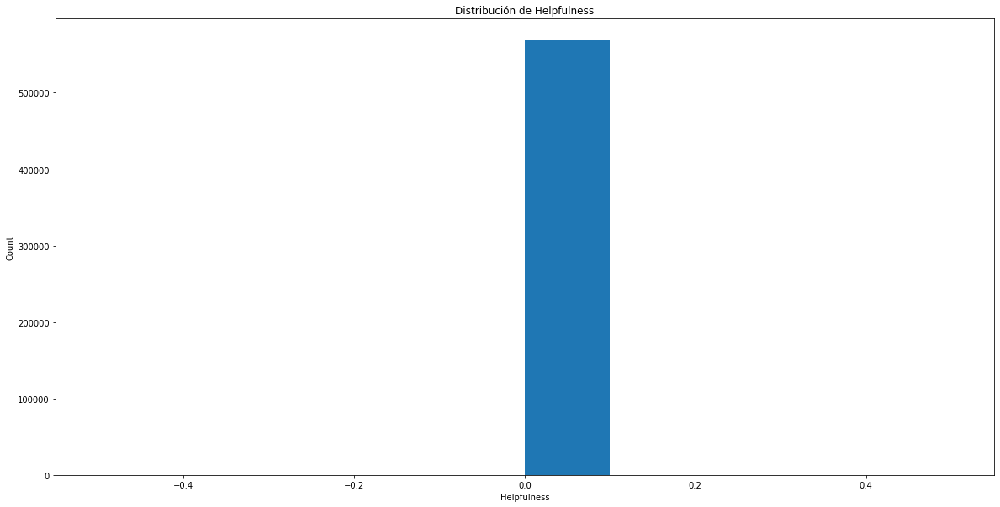

In [40]:
plt.figure(figsize=(20,10))
plt.title("Distribución de Helpfulness")
plt.xlabel("Helpfulness")
plt.ylabel("Count")
plt.hist(helpfulness[abs(helpfulness-helpfulness.mean())<=3*helpfulness.std()])
plt.show()

In [41]:
helpfulness=helpfulness[abs(helpfulness-helpfulness.mean())<=3*helpfulness.std()]

In [42]:
df_pros["Pre_pros_helpfulness"]=helpfulness
del df_pros["Helpfulness"]
df_pros

,Score,Summary,Text,Pre_pros_helpfulness
0,5,Good Quality Dog Food,I have bought several of the Vitality canned d...,0.0
1,1,Not as Advertised,Product arrived labeled as Jumbo Salted Peanut...,0.0
2,4,"""Delight"" says it all",This is a confection that has been around a fe...,0.0
3,2,Cough Medicine,If you are looking for the secret ingredient i...,0.0
4,5,Great taffy,Great taffy at a great price. There was a wid...,0.0
...,...,...,...,...
568449,5,Will not do without,Great for sesame chicken..this is a good if no...,0.0
568450,2,disappointed,I'm disappointed with the flavor. The chocolat...,0.0
568451,5,Perfect for our maltipoo,"These stars are small, so you can give 10-15 o...",0.0
568452,5,Favorite Training and reward treat,These are the BEST treats for training and rew...,0.0


## Texto
### Summary

In [43]:
summary=df_pros["Summary"].copy()

In [44]:
summary.apply(lambda d:len(d)).describe()

count    568454.000000
mean         23.445887
std          14.028439
min           1.000000
25%          13.000000
50%          20.000000
75%          30.000000
max         128.000000
Name: Summary, dtype: float64

Vamos a filtrar a 3 desviaciones estandares del promedio para eliminar datos atípicos

In [45]:
summary=summary[abs(summary.apply(lambda d:len(d))-23.44)<=3*14.02]

<AxesSubplot:title={'center':'Size distribution of Summary'}, ylabel='Frequency'>

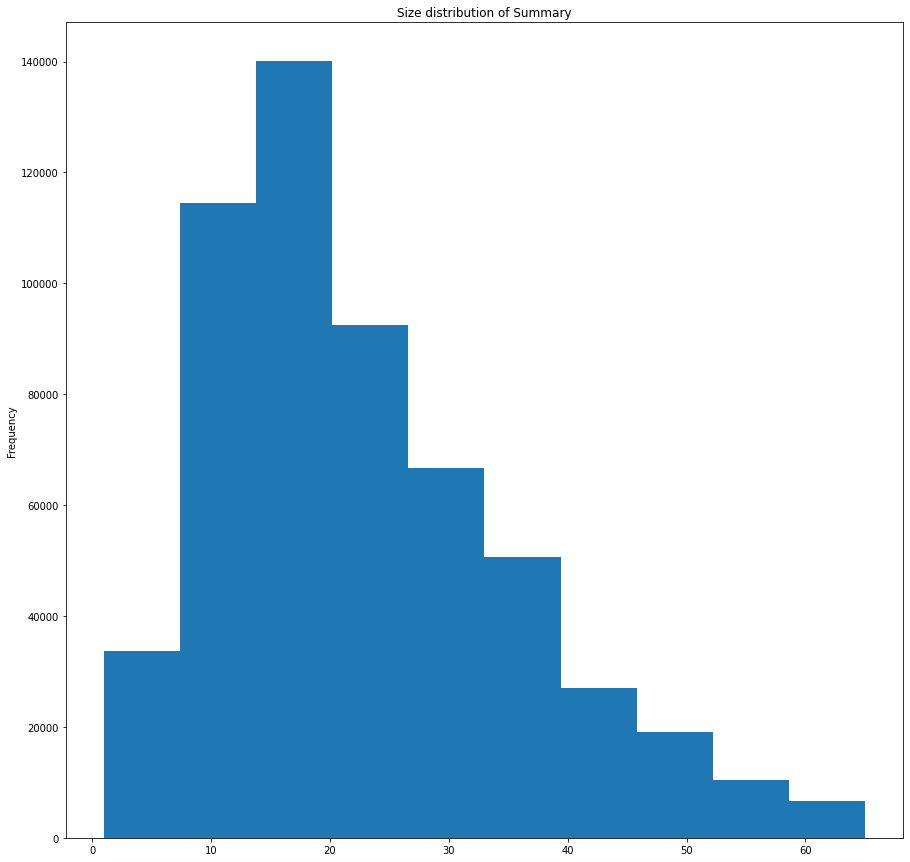

In [46]:
plt.figure(figsize=(15,15))
plt.title("Size distribution of Summary")
summary.apply(lambda d:len(d)).plot.hist()

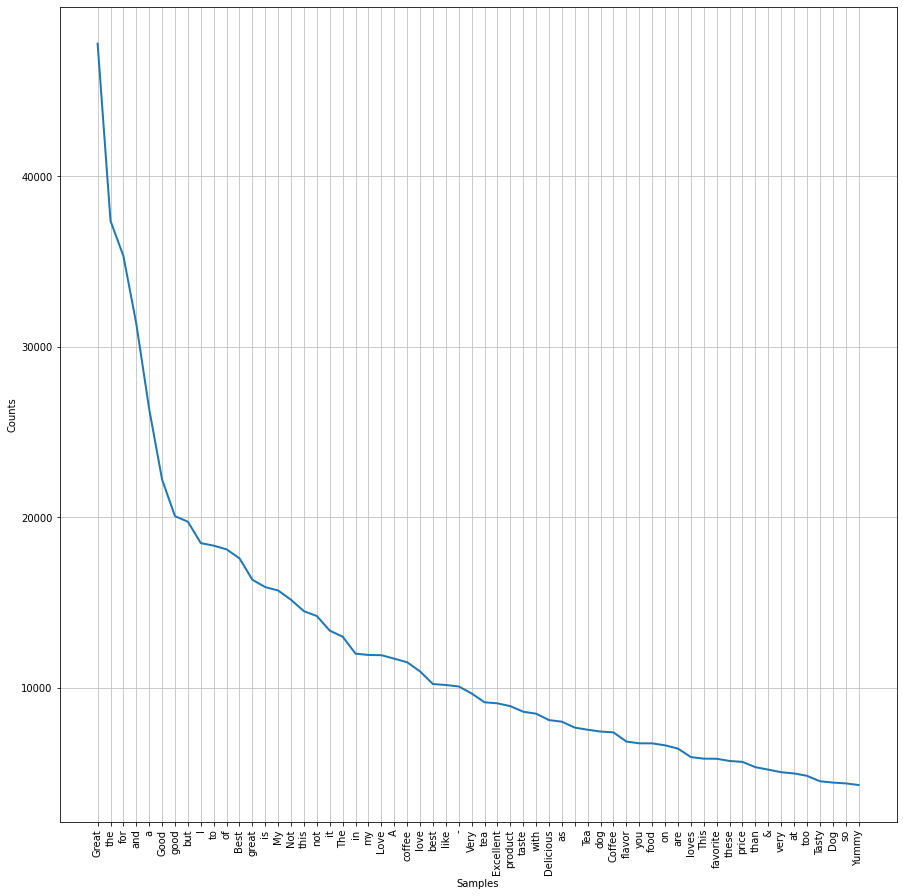

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [47]:
frequency_dist = nltk.FreqDist(list(chain.from_iterable(summary.apply(lambda d: d.split(' ')).values)))
plt.figure(figsize=(15,15))
frequency_dist.plot(60,cumulative=False)

In [48]:
summary=summary.apply(contractions.fix) 

In [49]:
summary=summary.apply(lambda s: nltk.pos_tag(nltk.word_tokenize(s.lower()),tagset='universal'))

In [50]:
summary=summary.apply(lambda d:[w[0] for w in d if w[1] in ["VERB","ADJ","ADV"]])

In [51]:
df_pros["Pre_pros_summary"]=summary
del df_pros["Summary"]
df_pros

,Score,Text,Pre_pros_helpfulness,Pre_pros_summary
0,5,I have bought several of the Vitality canned d...,0.0,[good]
1,1,Product arrived labeled as Jumbo Salted Peanut...,0.0,"[not, advertised]"
2,4,This is a confection that has been around a fe...,0.0,[says]
3,2,If you are looking for the secret ingredient i...,0.0,[]
4,5,Great taffy at a great price. There was a wid...,0.0,[great]
...,...,...,...,...
568449,5,Great for sesame chicken..this is a good if no...,0.0,"[will, not, do]"
568450,2,I'm disappointed with the flavor. The chocolat...,0.0,[disappointed]
568451,5,"These stars are small, so you can give 10-15 o...",0.0,[]
568452,5,These are the BEST treats for training and rew...,0.0,[favorite]


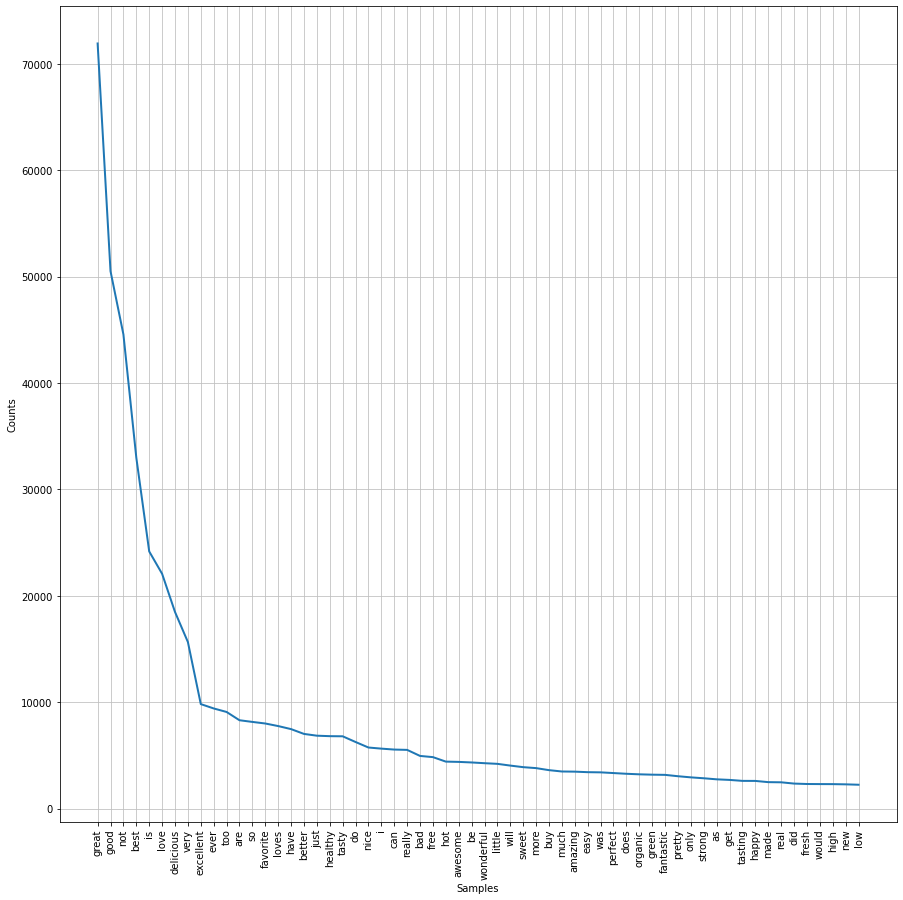

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [52]:
frequency_dist = nltk.FreqDist(list(chain.from_iterable(summary.values)))
plt.figure(figsize=(15,15))
frequency_dist.plot(60,cumulative=False)

<AxesSubplot:title={'center':'Size distribution of Summary_filtered'}, ylabel='Frequency'>

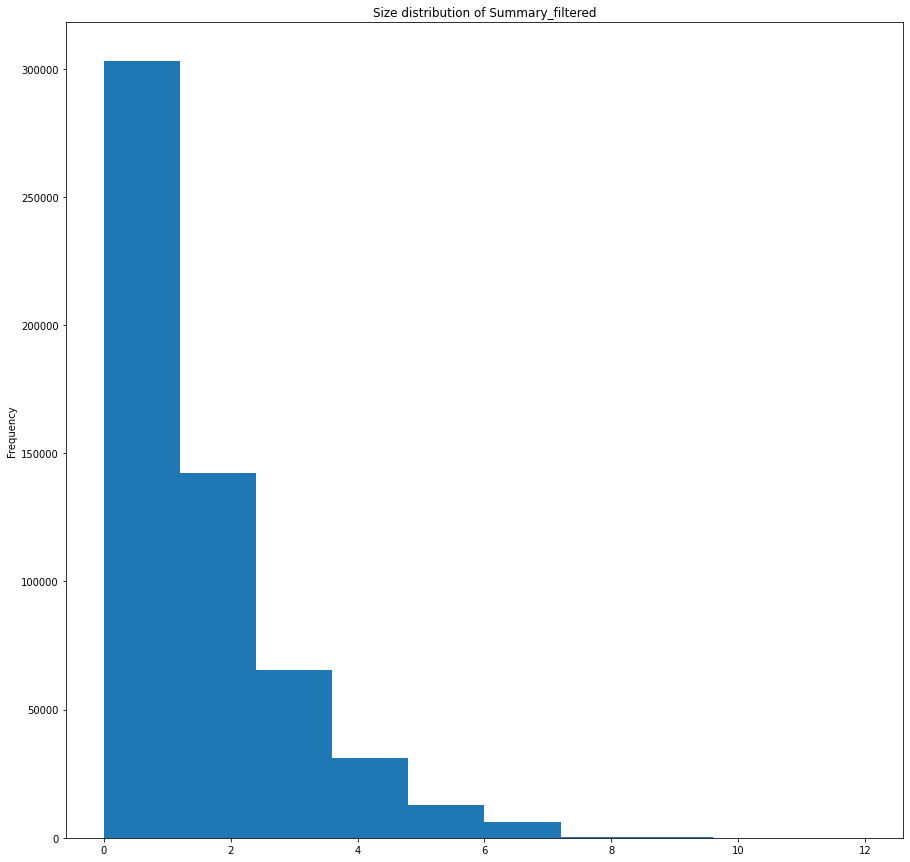

In [53]:
plt.figure(figsize=(15,15))
plt.title("Size distribution of Summary_filtered")
summary.apply(lambda d:len(d)).plot.hist()

## Text

In [54]:
text=df_pros["Text"].copy()

In [55]:
text.apply(lambda d:len(d)).describe()

count    568454.000000
mean        436.222083
std         445.339741
min          12.000000
25%         179.000000
50%         302.000000
75%         527.000000
max       21409.000000
Name: Text, dtype: float64

Vamos a filtrar a 3 desviaciones estandares del promedio para eliminar datos atípicos

In [56]:
text=text[abs(text.apply(lambda d:len(d))-436.222)<=3*445.339]

<AxesSubplot:title={'center':'Size distribution of Text'}, ylabel='Frequency'>

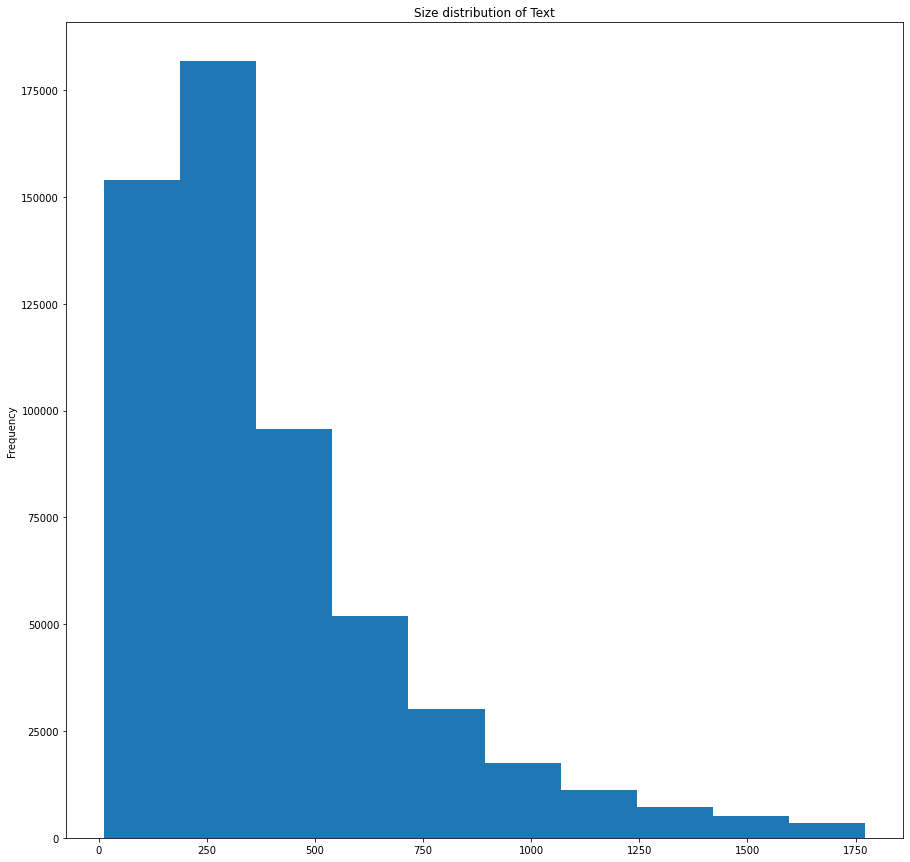

In [57]:
plt.figure(figsize=(15,15))
plt.title("Size distribution of Text")
text.apply(lambda d:len(d)).plot.hist()

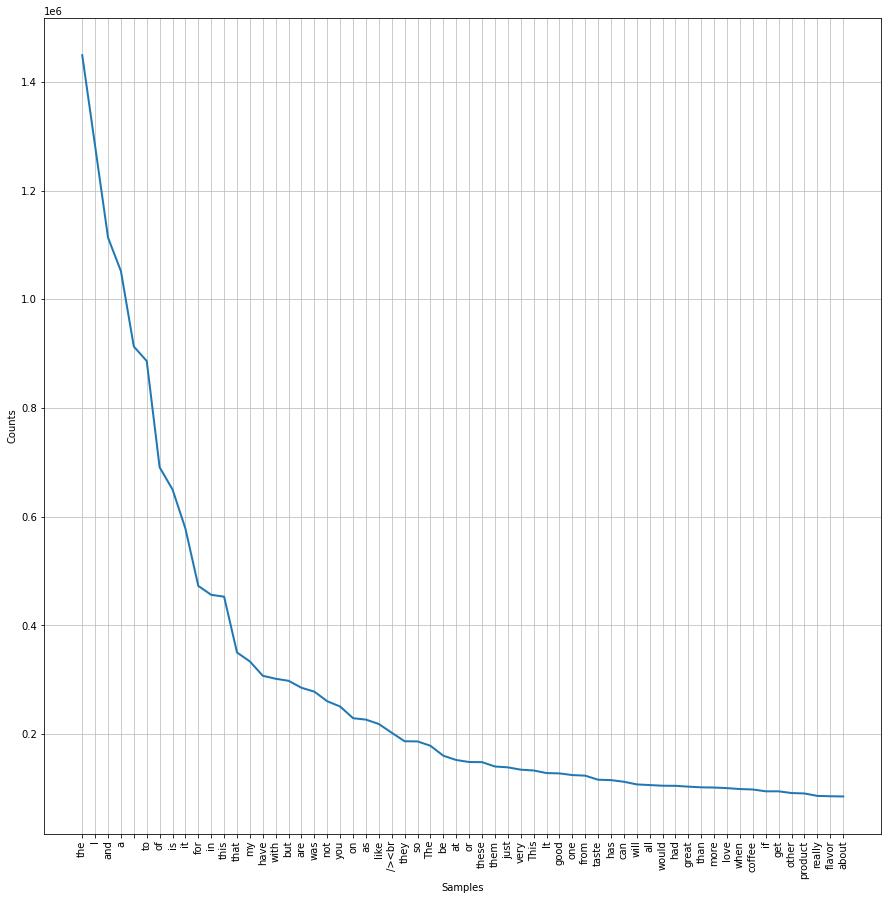

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [58]:
frequency_dist = nltk.FreqDist(list(chain.from_iterable(text.apply(lambda d: d.split(' ')).values)))
plt.figure(figsize=(15,15))
frequency_dist.plot(60,cumulative=False)

In [59]:
text=text.apply(contractions.fix)

In [60]:
text=text.apply(lambda s: nltk.pos_tag(nltk.word_tokenize(s.lower()),tagset='universal'))

In [61]:
text=text.apply(lambda d:[w[0] for w in d if w[1] in ["VERB","ADJ","ADV"]])

In [62]:
df_pros["Pre_pros_text"]=text
del df_pros["Text"]
df_pros

,Score,Pre_pros_helpfulness,Pre_pros_summary,Pre_pros_text
0,5,0.0,[good],"[have, bought, several, canned, dog, have, fou..."
1,1,0.0,"[not, advertised]","[arrived, labeled, salted, were, actually, sma..."
2,4,0.0,[says],"[is, has, been, few, is, light, pillowy, filbe..."
3,2,0.0,[],"[are, looking, secret, believe, have, found, i..."
4,5,0.0,[great],"[great, great, was, wide, was, very, quick, is]"
...,...,...,...,...
568449,5,0.0,"[will, not, do]","[great, is, good, not, better, have, eaten, lo..."
568450,2,0.0,[disappointed],"[am, disappointed, are, especially, weak, thic..."
568451,5,0.0,[],"[are, small, can, give, tried, train, just, ma..."
568452,5,0.0,[favorite],"[are, best, rewarding, being, good, grooming, ..."


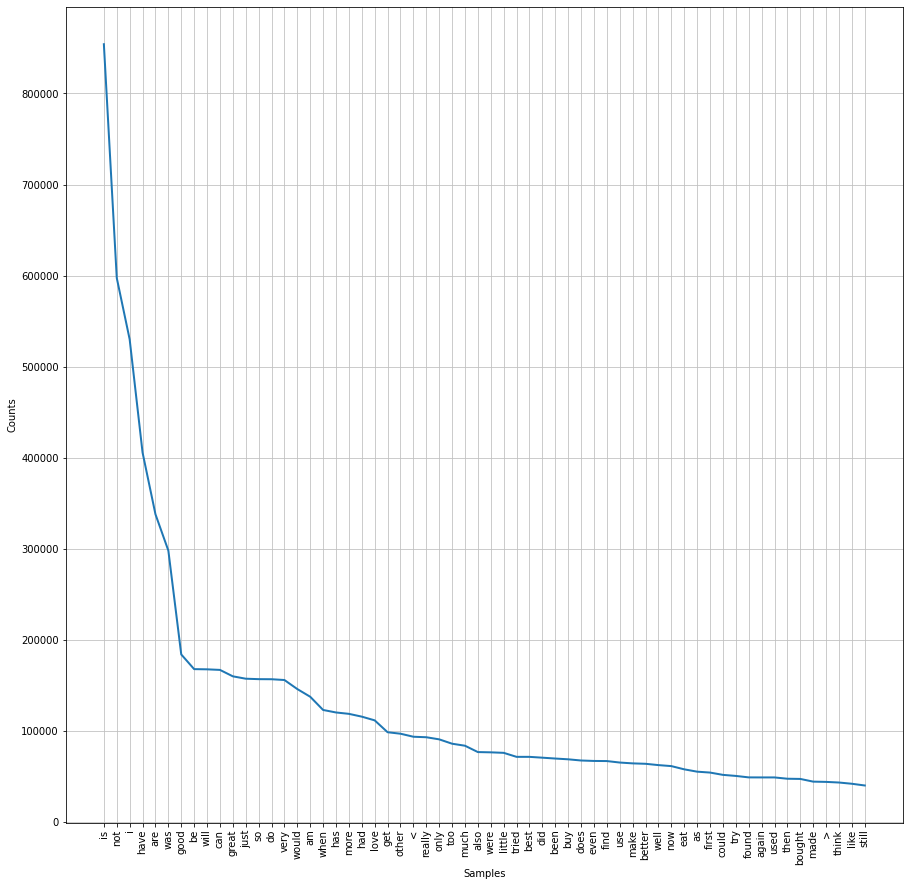

<AxesSubplot:xlabel='Samples', ylabel='Counts'>

In [63]:
frequency_dist = nltk.FreqDist(list(chain.from_iterable(text.values)))
plt.figure(figsize=(15,15))
frequency_dist.plot(60,cumulative=False)

<AxesSubplot:title={'center':'Size distribution of Text_filtered'}, ylabel='Frequency'>

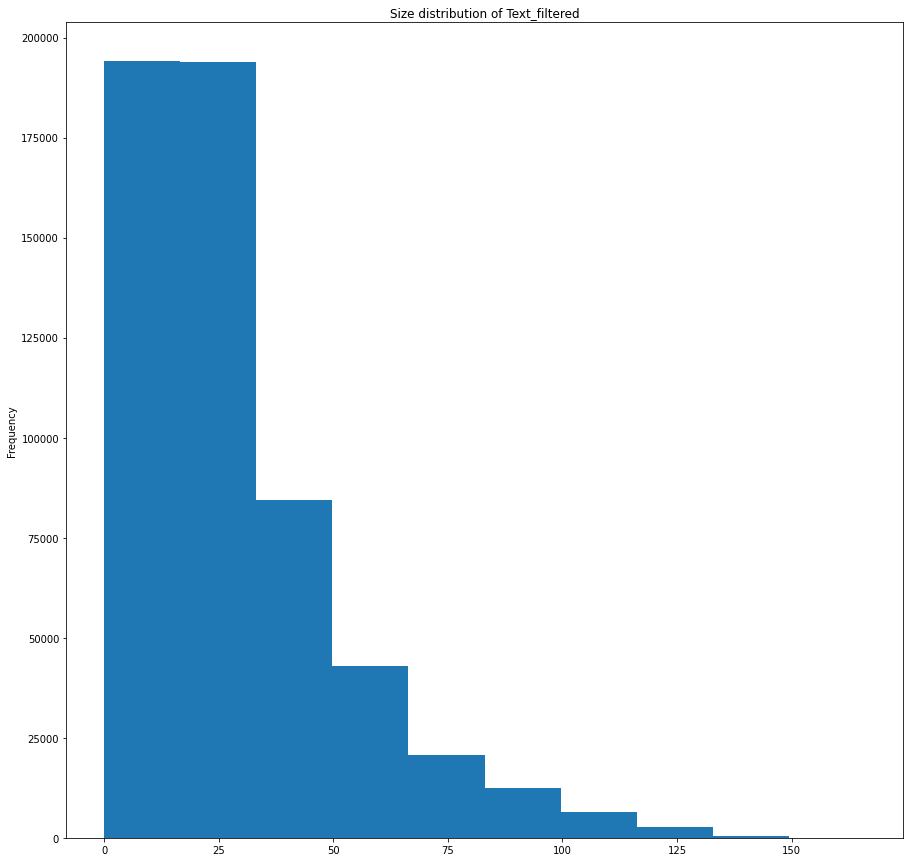

In [64]:
plt.figure(figsize=(15,15))
plt.title("Size distribution of Text_filtered")
text.apply(lambda d:len(d)).plot.hist()

## Mutual 

In [65]:
df_pros=df_pros.dropna()

In [66]:
df_pros.head()

,Score,Pre_pros_helpfulness,Pre_pros_summary,Pre_pros_text
0,5,0.0,[good],"[have, bought, several, canned, dog, have, fou..."
1,1,0.0,"[not, advertised]","[arrived, labeled, salted, were, actually, sma..."
2,4,0.0,[says],"[is, has, been, few, is, light, pillowy, filbe..."
3,2,0.0,[],"[are, looking, secret, believe, have, found, i..."
4,5,0.0,[great],"[great, great, was, wide, was, very, quick, is]"


In [67]:
summary=df_pros["Pre_pros_summary"].apply(lambda d: ' '.join(d)).copy()
text=df_pros["Pre_pros_text"].apply(lambda d: ' '.join(d)).copy()

In [68]:
text=text[text!='']
summary=summary[summary!='']

In [69]:
df_final=pd.concat([df_pros["Score"],df_pros["Pre_pros_helpfulness"],summary,text],axis=1)
df_final.head()

,Score,Pre_pros_helpfulness,Pre_pros_summary,Pre_pros_text
0,5,0.0,good,have bought several canned dog have found be g...
1,1,0.0,not advertised,arrived labeled salted were actually small siz...
2,4,0.0,says,is has been few is light pillowy filberts is c...
3,2,0.0,NaN,are looking secret believe have found i got or...
4,5,0.0,great,great great was wide was very quick is


In [70]:
df_final=df_final.dropna()

In [3]:
tfidf_summary=TfidfVectorizer().fit(df_final["Pre_pros_summary"])
tfidf_text=TfidfVectorizer().fit(df_final["Pre_pros_text"])

In [72]:
df_final.to_csv("ProcessedDF.csv")

# Create model

In [2]:
#Por el tamaño de los datos haremos los modelos con una muestra aleatoria
df_model=pd.read_csv("ProcessedDF.csv")

In [4]:
df_model

,Unnamed: 0,Score,Pre_pros_helpfulness,Pre_pros_summary,Pre_pros_text
0,0,5,0.0,good,have bought several canned dog have found be g...
1,1,1,0.0,not advertised,arrived labeled salted were actually small siz...
2,2,4,0.0,says,is has been few is light pillowy filberts is c...
3,4,5,0.0,great,great great was wide was very quick is
4,5,4,0.0,nice,got wild ordered was very enjoyable many only ...
...,...,...,...,...,...
457253,568448,5,0.0,very large,only is is so much i do not use huge i gave go...
457254,568449,5,0.0,will not do,great is good not better have eaten loved will...
457255,568450,2,0.0,disappointed,am disappointed are especially weak thickens s...
457256,568452,5,0.0,favorite,are best rewarding being good grooming lower l...


In [4]:
y=["Score"]

In [5]:
X_text=tfidf_text.transform(df_model["Pre_pros_text"].values)
X_summary=tfidf_summary.transform(df_model["Pre_pros_summary"].values)
X_helpfulness=csc_matrix(df_model[["Pre_pros_helpfulness"]].values,dtype='float64')
X_final=hstack([X_text,X_summary,X_helpfulness],dtype='float64',format="csr")

In [6]:
X_final

<457258x66465 sparse matrix of type '<class 'numpy.float64'>'
	with 12056493 stored elements in Compressed Sparse Row format>

## SGD Classifier

In [11]:
parameters={'penalty':["l1","l2"],'loss':["hinge","log","modified_huber"]}

In [12]:
SGD=SGDClassifier(n_jobs=-1)

In [ ]:
SGD_Best=GridSearchCV(SGD,parameters,cv=10).fit(X_final,df_model[y].values).best_estimator_

C:\Users\Nicolas\anaconda3\lib\site-packages\sklearn\utils\validation.py:73: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


In [ ]:
SGD_Best

## Bernoulli Naive Bayes

In [ ]:
parameters={'alpha':[0,0.5,1]}

In [ ]:
BNB=BernoulliNB()

In [ ]:
BNB_Best=GridSearchCV(BNB,parameters).fit(X_final,df_model[y].values).best_estimator_

In [ ]:
BNB_Best

## K Nearest Neighbors

In [ ]:
parameters={'n_neighbors':[1,2,3,4,5,6,7],'weights':["uniform","distance"]}

In [ ]:
KNN=KNeighborsClassifier(n_jobs=-1)

In [ ]:
KNN_Best=GridSearchCV(KNN,parameters).fit(X_final,df_model[y].values).best_estimator_

In [ ]:
KNN_Best

# Evaluation

In [68]:
print(classification_report(df_model[y].values, SGD_Best.predict(X_final)))

              precision    recall  f1-score   support

           1       0.68      0.75      0.71     41377
           2       0.64      0.25      0.36     24342
           3       0.60      0.34      0.43     34953
           4       0.58      0.25      0.35     65191
           5       0.80      0.97      0.88    291395

    accuracy                           0.76    457258
   macro avg       0.66      0.51      0.55    457258
weighted avg       0.73      0.76      0.73    457258



In [69]:
print(classification_report(df_model[y].values, BNB_Best.predict(X_final), labels=[1, 2, 3, 4, 5]))

              precision    recall  f1-score   support

           1       0.71      0.77      0.74     41377
           2       0.60      0.52      0.55     24342
           3       0.56      0.52      0.54     34953
           4       0.53      0.46      0.49     65191
           5       0.85      0.89      0.87    291395

    accuracy                           0.77    457258
   macro avg       0.65      0.63      0.64    457258
weighted avg       0.76      0.77      0.76    457258



In [ ]:
print(classification_report(df_model[y].values, KNN_Best.predict(X_final), labels=[1, 2, 3, 4, 5]))